In [1]:
import numpy as np 
import matplotlib.pyplot as plt
import random

In [2]:

def get_closest_position_in_list(position_list : list, pos : tuple) -> tuple:
  """
  Finds the position which have the shortest position from a current position

  Input parameters:
    position_list : list of positions to calculate distance of
    pos           : position to find the distance with respect to 
  """
  assert position_list, "List must be non-empty"

  shortest_distance_pos : tuple = position_list[0]
  shortest_distance : float = np.linalg.norm(np.array(shortest_distance_pos) - np.array(pos))

  for position in position_list:
    distance : float = np.linalg.norm(np.array(position) - np.array(pos)) # Will calculate the first position twice
    if distance < shortest_distance:
      shortest_distance = distance
      shortest_distance_pos = position

  return shortest_distance_pos


def obstacle_free_RRT(xy_0 : tuple, xy_target : tuple, distance_target_hit : float, world_dimensions : tuple) -> tuple:
  """
  Perform the RRT-algorithm without any obstacles
  
  Input parameters:
    xy_0                : initial position
    xy_target           : target position
    distance_target_hit : distance to assume the target has been achieved
    world_dimensions    : size of the world in (max_height, max_width)

  Output:
    list of coordinates tested before achieving the target 
  """

  max_height, max_width = world_dimensions
  assert (xy_0[0] <= max_width and xy_0[1] <= max_height) and (xy_0[0] >= 0 and xy_0[1] >= 0), "Dimensions must fit"
  assert (xy_target[0] <= max_width and xy_target[1] <= max_height) and (xy_target[0] >= 0 and xy_target[1] >= 0), "Dimensions must fit"

  positions_list : list = [xy_0]
  edges_list : list = []

  target_achieved : bool = False 

  while not target_achieved:
    # Create random position
    random_x : int = random.randint(0, max_width)
    random_y : int = random.randint(0, max_height)
    random_pos : tuple = (random_x, random_y) 

    if random_pos in positions_list:
      continue

    # Get the closest position and create an edge between these
    closest_pos : tuple = get_closest_position_in_list(positions_list, random_pos)
    edges_list.append((closest_pos, random_pos))
    positions_list.append(random_pos)
    
    # Check if target reached
    distance_to_target : float = np.linalg.norm(np.array(random_pos) - np.array(xy_target))
    if distance_to_target <= distance_target_hit:
      print("Target achieved with distance: {}".format(distance_to_target))
      break

  return positions_list, edges_list


In [3]:
def check_line_segment_intersection(xy_start_0 : tuple, xy_end_0 : tuple, xy_start_1 : tuple, xy_end_1 : tuple) -> bool:
  """
  Checks if there is a line-intersection between two lines
  """
  # https://en.wikipedia.org/wiki/Intersection_(geometry)#Two_line_segments

  # s(x_2-x_1)-t(x_4-x_3)=x_3-x_1,
  # s(y_2-y_1)-t(y_4-y_3)=y_3-y_1

  dpos_0 : np.ndarray = np.array(xy_end_0) - np.array(xy_start_0)
  dpos_1 : np.ndarray = np.array(xy_end_1) - np.array(xy_start_1)

  x2_min_x1 : float = dpos_0[0]
  x3_min_x1 : float = xy_start_1[0] - xy_start_0[0]
  x4_min_x3 : float = dpos_1[0]

  y2_min_y1 : float = dpos_0[1]
  y3_min_y1 : float = xy_start_1[1] - xy_start_0[1]
  y4_min_y3 : float = dpos_1[1]

  A : np.ndarray = np.array(
    [
      [x2_min_x1, -x4_min_x3],
      [y2_min_y1, -y4_min_y3]
    ]
  )
  B : np.ndarray = np.array(
    [
      [x3_min_x1],
      [y3_min_y1]
    ]
  )

  if np.abs(np.linalg.det(A)) <= 1e-10:
    # Parallel line segments
    return False

  val : np.ndarray = np.linalg.inv(A) @ B 
  s : float = val[0]
  t : float = val[1]

  return (0 < s < 1) and (0 < t < 1)


def check_obstacle_free_straight_line_path(xy_start : tuple, xy_end : tuple, obstacles : list = []) -> bool:
  """
  Checks whether the straight-line path between two points contains any obstacles

  Input parameters:
    xy_start  : list of positions to calculate distance of
    xy_end    : position to find the distance with respect to 
    obstacles : list of coordinates containing any obstacles

  Output:
    boolean indicating whether the straight-line path between the two coordinates
    is free of obstacles
  """
  if not obstacles:
    return True

  # Iterate over each obstacle, and detect if there are any intersections 
  # between the straight line path and the edges of the obstacle
  for obstacle in obstacles:
    assert len(obstacle) % 2 == 0, "Obstacles with num corners 2n + 1 not implemented yet"
    
    for corner_idx in range(len(obstacle) - 1):
      current_corner = obstacle[corner_idx]
      next_corner = obstacle[corner_idx + 1]

      # line = LineString([(xy_start), (xy_end)])
      # corner_line = LineString([(current_corner), (next_corner)])

      if not check_line_segment_intersection(xy_start, xy_end, current_corner, next_corner): #line.intersects(corner_line):
        print("Obstacle hit from {} to {} at corner-idx: {}".format(xy_start, xy_end, corner_idx))
        return False

  return True

def RRT_with_obstacles(xy_0 : tuple, xy_target : tuple, distance_target_hit : float, world_dimensions : tuple, obstacles : list = []) -> tuple:
  """
  Perform the RRT-algorithm with obstacles
  
  Input parameters:
    xy_0                : initial position
    xy_target           : target position
    distance_target_hit : distance to assume the target has been achieved
    world_dimensions    : size of the world in (max_height, max_width)

  Output:
    list of coordinates tested before achieving the target 
  """

  max_height, max_width = world_dimensions
  assert (xy_0[0] <= max_width and xy_0[1] <= max_height) and (xy_0[0] >= 0 and xy_0[1] >= 0), "Dimensions must fit"
  assert (xy_target[0] <= max_width and xy_target[1] <= max_height) and (xy_target[0] >= 0 and xy_target[1] >= 0), "Dimensions must fit"

  positions_list : list = [xy_0]
  edges_list : list = []

  target_achieved : bool = False 
  best_distance_to_target : float = None

  while not target_achieved:
    # Create random position
    random_x : int = random.randint(0, max_width)
    random_y : int = random.randint(0, max_height)
    random_pos : tuple = (random_x, random_y) 

    if random_pos in positions_list:
      continue

    # Get the closest position and create an edge between these, if the direct
    # path is free from any obstacles
    closest_pos : tuple = get_closest_position_in_list(positions_list, random_pos)
    obstacle_free : bool = check_obstacle_free_straight_line_path(closest_pos, random_pos, obstacles) 

    if not obstacle_free:
      # I assume that there is at least one robust path, such that it will not 
      # loop forever
      continue

    edges_list.append((closest_pos, random_pos))
    positions_list.append(random_pos)
    
    # Check if target reached
    distance_to_target : float = np.linalg.norm(np.array(random_pos) - np.array(xy_target))
    if distance_to_target <= distance_target_hit:
      print("Target achieved with distance: {}".format(distance_to_target))
      break

    if best_distance_to_target is None or distance_to_target < best_distance_to_target:
      best_distance_to_target = distance_to_target 
      print("Current best distance to target: {}".format(best_distance_to_target))

  return positions_list, edges_list

Target achieved with distance: 42.04759208325728


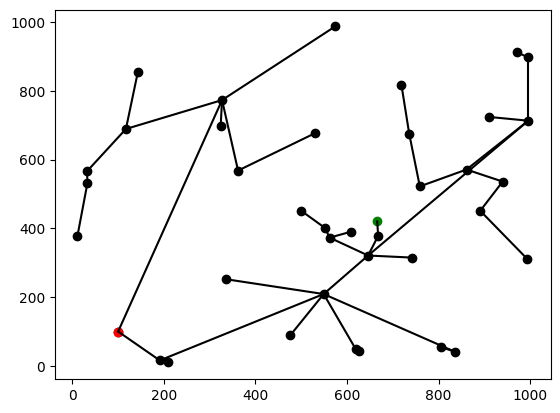

Red is the initial position
Green is the target position
Black are serarched points


In [11]:
"""
This is an obstacle-free version of the RRT, which was first developed to check 
that the algorithm worked 
"""

xy_0 : tuple = (100, 100)
xy_target : tuple = (666, 420)

world_width = 1000
world_height = 1000 

distance_target_hit = 50

# Create obstacles and run RRT
searched_positions, edges = obstacle_free_RRT(xy_0, xy_target, distance_target_hit, (world_width, world_height))

# Plot the positions
x_positions : list = [pos[0] for pos in searched_positions]
y_positions : list = [pos[1] for pos in searched_positions]

plt.scatter(x_positions, y_positions, marker="o", color="k")
plt.scatter([xy_target[0]], [xy_target[1]], marker="o", color="green")
plt.scatter([xy_0[0]], [xy_0[1]], marker="o", color="red")

# Plot the edges
for edge in edges:
  start_pos : tuple = edge[0]
  end_pos : tuple = edge[1]
  plt.plot([start_pos[0], end_pos[0]], [start_pos[1], end_pos[1]], 'k-')

# Plotting the last edge to the target
plt.plot([x_positions[-1], xy_target[0]], [y_positions[-1], xy_target[1]], 'k-')

plt.show()
print("Red is the initial position")
print("Green is the target position")
print("Black are serarched points")

In [12]:
"""
This version tried to add obstacles, but was not successful.
There is a slight error in the function 'check_line_segment_intersection', such 
that it is always triggered. That causes problems, as it never converges. Idk why
"""

# Create obstacles and run RRT
obstacles = [[(x, y) for x in range(150, 451, 300) for y in range(600, 801, 200)]] # Only create corners of the obstacle
searched_positions, edges = RRT_with_obstacles(xy_0, xy_target, distance_target_hit, (world_width, world_height), obstacles)

# Plot the positions
x_positions : list = [pos[0] for pos in searched_positions]
y_positions : list = [pos[1] for pos in searched_positions]

plt.scatter(x_positions, y_positions, marker="o", color="k")
plt.scatter([xy_target[0]], [xy_target[1]], marker="o", color="green")
plt.scatter([xy_0[0]], [xy_0[1]], marker="o", color="red")

# Plot the edges
for edge in edges:
  start_pos : tuple = edge[0]
  end_pos : tuple = edge[1]
  plt.plot([start_pos[0], end_pos[0]], [start_pos[1], end_pos[1]], 'k-')

# Plotting the last edge to the target
plt.plot([x_positions[-1], xy_target[0]], [y_positions[-1], xy_target[1]], 'k-')

# Plotting obstacles
if obstacles:
  plt.plot([obst[0] for obst in obstacles], [obst[1] for obst in obstacles], 'r-')

plt.show()


Obstacle hit from (100, 100) to (519, 786) at corner-idx: 0
Obstacle hit from (100, 100) to (382, 136) at corner-idx: 0
Obstacle hit from (100, 100) to (834, 176) at corner-idx: 0
Obstacle hit from (100, 100) to (632, 84) at corner-idx: 0
Obstacle hit from (100, 100) to (867, 561) at corner-idx: 0
Obstacle hit from (100, 100) to (399, 391) at corner-idx: 0
Obstacle hit from (100, 100) to (983, 466) at corner-idx: 0
Obstacle hit from (100, 100) to (224, 888) at corner-idx: 0
Obstacle hit from (100, 100) to (857, 912) at corner-idx: 0
Obstacle hit from (100, 100) to (840, 476) at corner-idx: 0
Obstacle hit from (100, 100) to (262, 443) at corner-idx: 0
Obstacle hit from (100, 100) to (526, 301) at corner-idx: 0
Obstacle hit from (100, 100) to (491, 775) at corner-idx: 0
Obstacle hit from (100, 100) to (83, 260) at corner-idx: 0
Obstacle hit from (100, 100) to (450, 995) at corner-idx: 0
Obstacle hit from (100, 100) to (802, 3) at corner-idx: 0
Obstacle hit from (100, 100) to (652, 589) a

KeyboardInterrupt: 